# Import lib

In [1]:
!pip install ffmpegcv

In [2]:
import IPython.display as ipd
import numpy as np
import matplotlib.pyplot as plt
import cv2
import ffmpegcv
import gc
import time
import PIL
from sklearn.cluster import DBSCAN
import os
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
import tensorflow as tf


In [3]:
from transnet_utils import draw_video_with_predictions, scenes_from_predictions
from low_level_filter import filter_blurry, filter_histogram,  process_hog
from medium_level_filter import check_GPU,get_CNN_model,preprocess_input_images,get_CNN_embeddings
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler,MinMaxScaler

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


# Loading the whole video for the process

In [ ]:
input_dir = "/kaggle/input/video-data/"
file = os.listdir(input_dir)
print(file)
video_path = input_dir+file[0]
print('Some information about the data:')
cap = cv2.VideoCapture(video_path)
print('Number of frames:', int(cap.get(cv2.CAP_PROP_FRAME_COUNT)))
print('Frame width:', int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)))
print('Frame height:', int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)))
print('Frame rate:', cap.get(cv2.CAP_PROP_FPS))

Some information about the data:
Number of frames: 28401
Frame width: 1280
Frame height: 720
Frame rate: 25.0


In [ ]:
gc.collect()
start = time.time()
cap = ffmpegcv.VideoCaptureNV(video_path, resize=(256, 256))
count = 0
save_frame = []

while True:
    ret, frame = cap.read()
    if not ret:
        break
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)  # Convert to RGB
    save_frame.append(frame_rgb)

print('ffmpegcv_readingtime:', (time.time() - start) * 1000, 'ms')
cap.release()

# Dropping frame:
save_frame = save_frame[::3]

ffmpegcv_readingtime: 28612.321138381958 ms


Number of frames: 9467


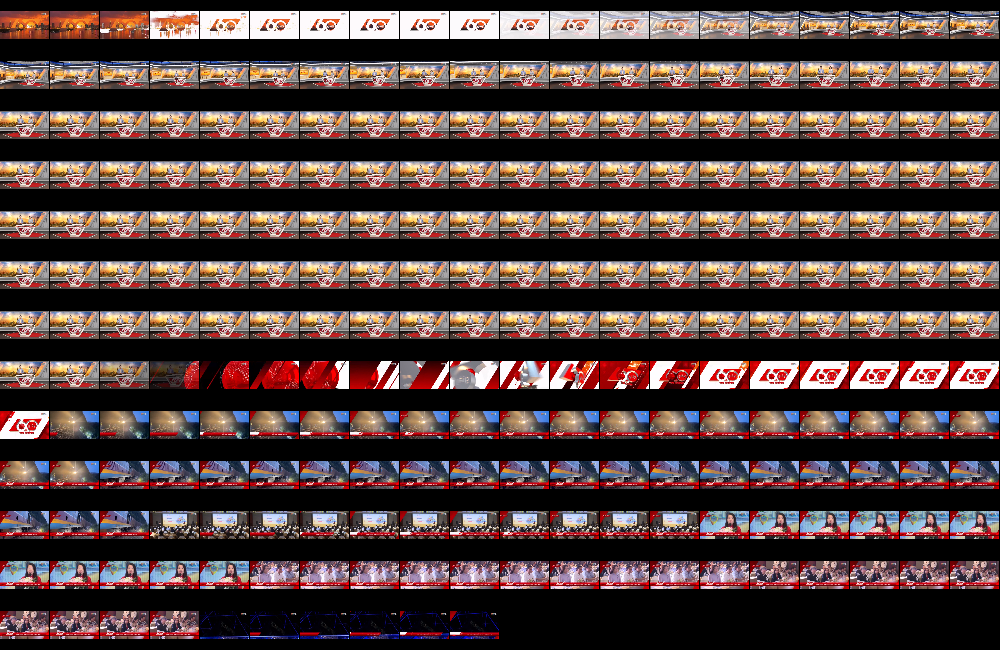

In [6]:
print('Number of frames:', len(save_frame))
save_frame = np.array(save_frame)
draw_video_with_predictions(save_frame[:250], np.zeros(250), threshold=0.1)

# Simple approach to down scale the size of dataset using similarity and DBScan cluster (low)

Image shape: (256, 256, 3)


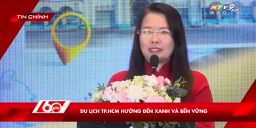

In [7]:
test_img = save_frame[220]
print('Image shape:', test_img.shape)
ipd.display(PIL.Image.fromarray(test_img[64:-64,:,:]))
del test_img

In [ ]:

# I'll provide an example of how to use DBSCAN (Density-Based Spatial Clustering of Applications with Noise) for clustering images based on their color histograms.

# First, you need to extract color histograms from the images. Then, you can use the DBSCAN algorithm to cluster these histograms. Here's a step-by-step guide:

#     Load Images and Extract Color Histograms
#     Use DBSCAN to Cluster the Histograms
#     Laplacian the images and remove the low variance images to eliminate the transition frames
#     Visualize the Clusters

# Here's the Python function used in the code:


# Extract color histograms for all images

def DBSCANER(images, eps = 0.5, min_samples = 5, plot=False):
    histograms = filter_histogram(images, color='gray')
    # Perform DBSCAN clustering
    dbscan = DBSCAN(eps=0.5, min_samples=5, metric='cosine')
    labels = dbscan.fit_predict(histograms)
    unique_labels = set(labels)
    if plot:
        plt.figure(figsize=(10, 10))
        for label in unique_labels:
            label_mask = (labels == label)
            clustered_image_paths = np.array(images)[label_mask]
            for i, image_path in enumerate(clustered_image_paths):
                image = cv2.imread(image_path)
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                plt.subplot(len(unique_labels), len(clustered_image_paths), i + 1)
                plt.imshow(image)
                plt.title(f"Cluster {label}")
                plt.axis('off')
        plt.show()
    return labels

def K_MeansGetDistance(X_std):
    neighbors = 10
    nbrs = NearestNeighbors(n_neighbors=neighbors,
                            metric='cosine',
                            algorithm='brute' ).fit(X_std)

    distances, indices = nbrs.kneighbors(X_std)

    distance_desc = sorted(distances[:, neighbors-1], reverse=True)


    plt.figure(figsize=(12, 8))
    plt.plot(list(range(1,len(distance_desc )+1)), distance_desc)


In order to find the epsilon parameters for the whole video, we do the plotting and find the elbow of the graph - this step can be done automatically by finding the farest points to the projection line.

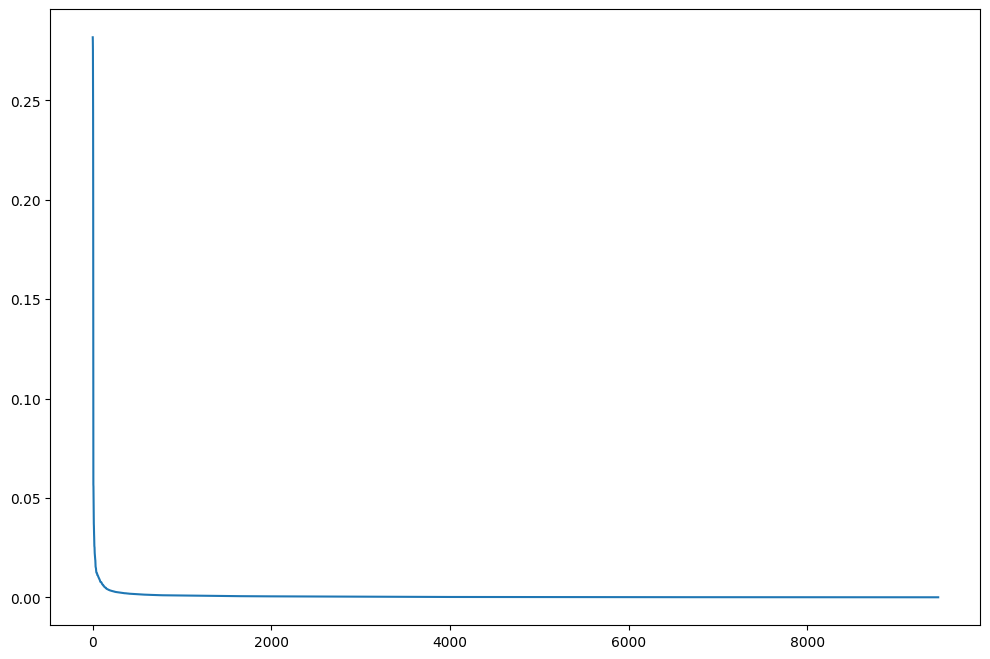

In [9]:
histograms = np.array(filter_histogram(save_frame, color='gray')).reshape(-1, 256)/(256*256)
position_encoding = np.array([i for i in range(len(histograms))]).reshape(-1,1)
position_encoding = np.sin(position_encoding / 82 * 2 * np.pi)/2 +0.6
histograms = histograms*position_encoding
del position_encoding
K_MeansGetDistance(histograms)

In [10]:

images = save_frame[100:180,:,:,:]
#Position Encoding
histograms_pos = histograms[100:180,:]

dbscan = DBSCAN(eps=0.001, min_samples=4, metric='cosine')
labels = dbscan.fit_predict(histograms_pos )
labels = MinMaxScaler().fit_transform(labels.reshape(-1,1)).reshape(-1)
# print('Number of clusters:', labels)
# draw_video_with_predictions(images, labels, threshold=0.1)


In [11]:
Scence = []
histograms = np.array(filter_histogram(save_frame, color='gray')).reshape(-1, 256)/(256*256)
position = np.arange(0,80)
last_end = -1
window = 41
for i in range(0,len(save_frame),window):
    images = save_frame[i:i+window,:,:,:]
    position = np.arange(i,i+len(images))
    histograms_batch = histograms[i:i+window]
    dbscan = DBSCAN(eps=0.005, min_samples=3, metric='cosine')
    labels = dbscan.fit_predict(histograms_batch)
    labels = MinMaxScaler().fit_transform(labels.reshape(-1,1)).reshape(-1)
    # Get 3 most common samples in each  labels
    unique_labels = set(labels)
    for label in unique_labels:
        label_mask = (labels == label)
        clustered_idx = position[label_mask]
        clustered_images = images[label_mask,:,:,:]
        #remove the blur or transition frame in a scence using laplacian
        fblur_idx = filter_blurry(clustered_images,threshold_percent=0.1)
        clustered_idx = clustered_idx[fblur_idx]
        random_indices = clustered_idx[np.random.choice(clustered_idx.shape[0], 5)]
        Scence.append(random_indices)
scence = np.concatenate(Scence,axis=0)
scence = np.unique(scence)
print('total number of scence:', scence.shape[0])

total number of scence: 1312


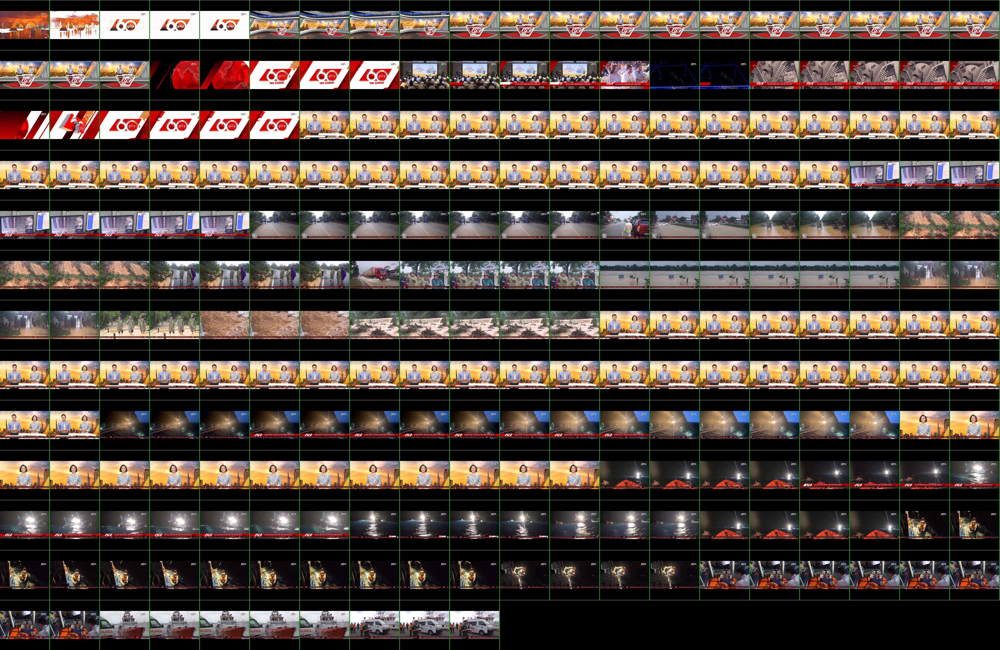

In [12]:
scence_frame = save_frame[scence,:,:,:]
del save_frame
scence_frame.shape
draw_video_with_predictions(scence_frame[:250], np.arange(250), threshold=0.1)

# USING CNN FOR FILTER AGAIN

In [13]:
model =get_CNN_model('MobileNetV2')

/kaggle/usr/lib/medium_level_filter/medium_level_filter.py:19: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  base_model = MobileNetV2(weights='imagenet', include_top=False)


9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


In [14]:
#Mapping index with id
dict_idx_id = {idx:id for idx,id in enumerate(scence)}
dict_id_idx= {id:idx for idx,id in enumerate(scence)}
embeddings = get_CNN_embeddings(model,scence_frame, batch_size=64)

I0000 00:00:1739530118.182827     120 service.cc:145] XLA service 0x7e316c0023f0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1739530118.182897     120 service.cc:153]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0


1/3 ━━━━━━━━━━━━━━━━━━━━ 9s 5s/step

I0000 00:00:1739530121.961338     120 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


3/3 ━━━━━━━━━━━━━━━━━━━━ 8s 1s/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 846ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


In [15]:
#Get the embeddings of the unimportant scence
unimportant_scence = []
path = '/kaggle/input/unimportant-frame/unimportant_frame/'
names = os.listdir(path)


for name in names:
    name = os.path.join(path,name)
    img = cv2.imread(name)
    img = cv2.resize(img,(299,299))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    unimportant_scence.append(img)
unimportant_scence = np.array(unimportant_scence)
unimportant_embedding = get_CNN_embeddings(model,unimportant_scence,batch_size=16)


1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


Total number of frame: 236


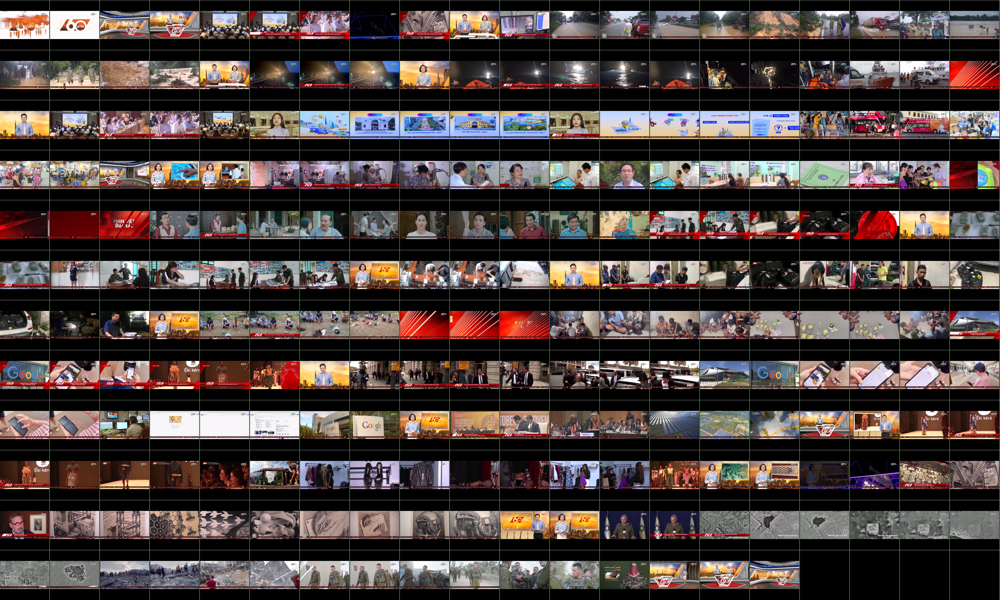

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity
from scipy.signal import argrelextrema
get_idx= []
transit_model = tf.keras.models.load_model("/kaggle/input/transition-detection/transition_detection.h5")
for i in range(1, embeddings.shape[0]):
    sim = cosine_similarity([embeddings[i]],unimportant_embedding)
    if np.max(sim) <=0.8:
        cosine_similarities = cosine_similarity([embeddings[i-1]], [embeddings[i]])
        if cosine_similarities < 0.85:
            get_idx.append(i)
get_id = [dict_idx_id[idx] for idx in get_idx]
get_id = np.array(get_id)
get_id = np.unique(get_id)
get_idx = [dict_id_idx[id] for id in get_id]
get_idx = np.array(get_idx).astype(np.int32)
print('Total number of frame:',get_id.shape[0])
scence_frame_ = scence_frame[get_idx,:,:,:]
draw_video_with_predictions(scence_frame_[:500], np.arange(500), threshold=0.1)

In [17]:
keyframe_dir = "/kaggle/working/Keyframes/"
if not os.path.exists(keyframe_dir):
    os.makedirs(keyframe_dir)
for i in range(len(scence_frame_)):
    cv2.imwrite(keyframe_dir+str(get_id[i])+'.webp',cv2.cvtColor(scence_frame_[i], cv2.COLOR_RGB2BGR))